### IMPORT AND PRELIMINARY CONSIDERATIONS

In [1]:
import os
import pandas as pd
import numpy as np
import datetime
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import plotly.express as px
import plotly.graph_objects as go
import matplotlib.dates as mdates 
xformatter = mdates.DateFormatter('%H:%M') # for time axis plots


import sklearn
from scipy.optimize import curve_fit

import warnings
warnings.filterwarnings('ignore')

Import Data

In [2]:
df_gen1 = pd.read_csv("Plant_1_Generation_Data.csv")
df_gen2 = pd.read_csv("Plant_2_Generation_Data.csv")

df_weather1 = pd.read_csv("Plant_1_Weather_Sensor_Data.csv")
df_weather2 = pd.read_csv("Plant_2_Weather_Sensor_Data.csv")

DataFrames' Informations

In [4]:
df_weather1.head()

,DATE_TIME,PLANT_ID,SOURCE_KEY,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION
0,2020-05-15 00:00:00,4135001,HmiyD2TTLFNqkNe,25.184316,22.857507,0.0
1,2020-05-15 00:15:00,4135001,HmiyD2TTLFNqkNe,25.084589,22.761668,0.0
2,2020-05-15 00:30:00,4135001,HmiyD2TTLFNqkNe,24.935753,22.592306,0.0
3,2020-05-15 00:45:00,4135001,HmiyD2TTLFNqkNe,24.846130,22.360852,0.0
4,2020-05-15 01:00:00,4135001,HmiyD2TTLFNqkNe,24.621525,22.165423,0.0


In [4]:
df_gen1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 68778 entries, 0 to 68777
Data columns (total 7 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   DATE_TIME    68778 non-null  object 
 1   PLANT_ID     68778 non-null  int64  
 2   SOURCE_KEY   68778 non-null  object 
 3   DC_POWER     68778 non-null  float64
 4   AC_POWER     68778 non-null  float64
 5   DAILY_YIELD  68778 non-null  float64
 6   TOTAL_YIELD  68778 non-null  float64
dtypes: float64(4), int64(1), object(2)
memory usage: 3.7+ MB


Column descriptions:

- DATE_TIME: Date and time for each observation. Observations recorded at 15 minute intervals.
- PLANT_ID: this will be common for the entire file
- SOURCE_KEY: Source key in this file stands for the inverter id.
- DC_POWER: Amount of DC power generated by the inverter (source_key) in this 15 minute interval. Units - kW.
- AC_POWER: Amount of AC power generated by the inverter (source_key) in this 15 minute interval. Units - kW.
- TOTAL_YIELD: This is the total yield for the inverter till that point in time.

In [8]:
df_gen1.describe()

,PLANT_ID,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD
count,68778.0,68778.000000,68778.000000,68778.000000,6.877800e+04
mean,4135001.0,3147.426211,307.802752,3295.968737,6.978712e+06
std,0.0,4036.457169,394.396439,3145.178309,4.162720e+05
min,4135001.0,0.000000,0.000000,0.000000,6.183645e+06
25%,4135001.0,0.000000,0.000000,0.000000,6.512003e+06
50%,4135001.0,429.000000,41.493750,2658.714286,7.146685e+06
75%,4135001.0,6366.964286,623.618750,6274.000000,7.268706e+06
max,4135001.0,14471.125000,1410.950000,9163.000000,7.846821e+06


In [13]:
df_gen2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 67698 entries, 0 to 67697
Data columns (total 7 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   DATE_TIME    67698 non-null  object 
 1   PLANT_ID     67698 non-null  int64  
 2   SOURCE_KEY   67698 non-null  object 
 3   DC_POWER     67698 non-null  float64
 4   AC_POWER     67698 non-null  float64
 5   DAILY_YIELD  67698 non-null  float64
 6   TOTAL_YIELD  67698 non-null  float64
dtypes: float64(4), int64(1), object(2)
memory usage: 3.6+ MB


In [14]:
df_gen2.describe()

,PLANT_ID,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD
count,67698.0,67698.000000,67698.000000,67698.000000,6.769800e+04
mean,4136001.0,246.701961,241.277825,3294.890295,6.589448e+08
std,0.0,370.569597,362.112118,2919.448386,7.296678e+08
min,4136001.0,0.000000,0.000000,0.000000,0.000000e+00
25%,4136001.0,0.000000,0.000000,272.750000,1.996494e+07
50%,4136001.0,0.000000,0.000000,2911.000000,2.826276e+08
75%,4136001.0,446.591667,438.215000,5534.000000,1.348495e+09
max,4136001.0,1420.933333,1385.420000,9873.000000,2.247916e+09


In [6]:
df_weather1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3182 entries, 0 to 3181
Data columns (total 6 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   DATE_TIME            3182 non-null   object 
 1   PLANT_ID             3182 non-null   int64  
 2   SOURCE_KEY           3182 non-null   object 
 3   AMBIENT_TEMPERATURE  3182 non-null   float64
 4   MODULE_TEMPERATURE   3182 non-null   float64
 5   IRRADIATION          3182 non-null   float64
dtypes: float64(3), int64(1), object(2)
memory usage: 149.3+ KB


- DATE_TIME and PLANT_ID already described
- SOURCE_KEY: Stands for the sensor panel id. This will be common for the entire file because there's only one sensor panel for the plant.
- AMBIENT_TEMPERATURE: This is the ambient temperature at the plant [°C] 
- MODULE_TEMPERATURE: There's a module (solar panel) attached to the sensor panel. This is the temperature reading for that module. [°C]
- IRRADATION: Amount of irradiation for the 15 minute interval. Note: After comparing this data with other publications, I assume the correct unit for this data is [kW/m^2]

In [9]:
df_weather1.describe()

,PLANT_ID,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION
count,3182.0,3182.000000,3182.000000,3182.000000
mean,4135001.0,25.531606,31.091015,0.228313
std,0.0,3.354856,12.261222,0.300836
min,4135001.0,20.398505,18.140415,0.000000
25%,4135001.0,22.705182,21.090553,0.000000
50%,4135001.0,24.613814,24.618060,0.024653
75%,4135001.0,27.920532,41.307840,0.449588
max,4135001.0,35.252486,65.545714,1.221652


In [15]:
df_weather2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3259 entries, 0 to 3258
Data columns (total 6 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   DATE_TIME            3259 non-null   object 
 1   PLANT_ID             3259 non-null   int64  
 2   SOURCE_KEY           3259 non-null   object 
 3   AMBIENT_TEMPERATURE  3259 non-null   float64
 4   MODULE_TEMPERATURE   3259 non-null   float64
 5   IRRADIATION          3259 non-null   float64
dtypes: float64(3), int64(1), object(2)
memory usage: 152.9+ KB


In [16]:
df_weather2.describe()

,PLANT_ID,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION
count,3259.0,3259.000000,3259.000000,3259.000000
mean,4136001.0,28.069400,32.772408,0.232737
std,0.0,4.061556,11.344034,0.312693
min,4136001.0,20.942385,20.265123,0.000000
25%,4136001.0,24.602135,23.716881,0.000000
50%,4136001.0,26.981263,27.534606,0.019040
75%,4136001.0,31.056757,40.480653,0.438717
max,4136001.0,39.181638,66.635953,1.098766


Check Missing Values

In [11]:
df_gen1.isnull().sum().sort_values(ascending=False)

DATE_TIME      0
PLANT_ID       0
SOURCE_KEY     0
DC_POWER       0
AC_POWER       0
DAILY_YIELD    0
TOTAL_YIELD    0
dtype: int64

In [17]:
df_gen2.isnull().sum().sort_values(ascending=False)

DATE_TIME      0
PLANT_ID       0
SOURCE_KEY     0
DC_POWER       0
AC_POWER       0
DAILY_YIELD    0
TOTAL_YIELD    0
dtype: int64

In [12]:
df_weather1.isnull().sum().sort_values(ascending=False)

DATE_TIME              0
PLANT_ID               0
SOURCE_KEY             0
AMBIENT_TEMPERATURE    0
MODULE_TEMPERATURE     0
IRRADIATION            0
dtype: int64

In [18]:
df_weather2.isnull().sum().sort_values(ascending=False)

DATE_TIME              0
PLANT_ID               0
SOURCE_KEY             0
AMBIENT_TEMPERATURE    0
MODULE_TEMPERATURE     0
IRRADIATION            0
dtype: int64

Check on PLANT_ID to verify the uniqueness of the plant in question

In [19]:
print(df_gen1['PLANT_ID'].nunique())
print(df_gen2['PLANT_ID'].nunique())
print(df_weather1['PLANT_ID'].nunique())
print(df_weather2['PLANT_ID'].nunique())

1
1
1
1


Control over number of inverters and number of measurements

In [20]:
df_gen1.SOURCE_KEY.value_counts()

SOURCE_KEY
bvBOhCH3iADSZry    3155
1BY6WEcLGh8j5v7    3154
7JYdWkrLSPkdwr4    3133
VHMLBKoKgIrUVDU    3133
ZnxXDlPa8U1GXgE    3130
ih0vzX44oOqAx2f    3130
z9Y9gH1T5YWrNuG    3126
wCURE6d3bPkepu2    3126
uHbuxQJl8lW7ozc    3125
pkci93gMrogZuBj    3125
iCRJl6heRkivqQ3    3125
rGa61gmuvPhdLxV    3124
sjndEbLyjtCKgGv    3124
McdE0feGgRqW7Ca    3124
zVJPv84UY57bAof    3124
ZoEaEvLYb1n2sOq    3123
1IF53ai7Xc0U56Y    3119
adLQvlD726eNBSB    3119
zBIq5rxdHJRwDNY    3119
WRmjgnKYAwPKWDb    3118
3PZuoBAID5Wc2HD    3118
YxYtjZvoooNbGkE    3104
Name: count, dtype: int64

In [21]:
df_gen1.SOURCE_KEY.value_counts().sum()

68778

In [31]:
print(f'There are {df_gen1.SOURCE_KEY.nunique()} different inverters. Number of measurements per inverter range from {df_gen1.SOURCE_KEY.value_counts().min()} to {df_gen1.SOURCE_KEY.value_counts().max()}.' )

There are 22 different inverters. Number of measurements per inverter range from 3104 to 3155.


As observed, there are 22 distinct inverters with measurement counts ranging from 3104 to 3155. This variance could potentially pose challenges for prediction models and needs to be considered. Given that each entry represents a 15-minute measurement interval, the maximum deviation of 51 entries translates to a discrepancy of nearly 13 hours.

### PREPROCESSING

Our objective is to merge the two datasets. To achieve this, we'll harmonize the DATE_TIME formats, remove any redundant columns, and merge the datasets based on the DATE_TIME column. Furthermore, we'll include distinct columns for date and time, and assign sequential names to our inverters, numbering them from 1 to 22.

In [33]:
# adjust datetime format
df_gen1['DATE_TIME'] = pd.to_datetime(df_gen1['DATE_TIME'],
                                      format = '%d-%m-%Y %H:%M')
df_weather1['DATE_TIME'] = pd.to_datetime(df_weather1['DATE_TIME'],
                                          format = '%Y-%m-%d %H:%M:%S')

# drop unnecessary columns and merge both dataframes along DATE_TIME
df_plant1 = pd.merge(df_gen1.drop(columns = ['PLANT_ID']), 
                     df_weather1.drop(columns = ['PLANT_ID', 'SOURCE_KEY']), 
                     on='DATE_TIME')

In [35]:
# add inverter number column to dataframe
sensorkeys = df_plant1.SOURCE_KEY.unique().tolist() # unique sensor keys
sensornumbers = list(range(1,len(sensorkeys)+1)) # sensor number
dict_sensor = dict(zip(sensorkeys, sensornumbers)) # dictionary of sensor numbers and corresponding keys

# add column
df_plant1['SENSOR_NUM'] = 0
for i in range(df_gen1.shape[0]):
    df_plant1['SENSOR_NUM'][i] = dict_sensor[df_gen1["SOURCE_KEY"][i]]

# add Sensor Number as string
df_plant1["SENSOR_NAME"] = df_plant1["SENSOR_NUM"].apply(str) # add string column of sensor name

In [36]:
# adding separate time and date columns
df_plant1["DATE"] = pd.to_datetime(df_plant1["DATE_TIME"]).dt.date # add new column with date
df_plant1["TIME"] = pd.to_datetime(df_plant1["DATE_TIME"]).dt.time # add new column with time

# add hours and minutes for ml models
df_plant1['HOURS'] = pd.to_datetime(df_plant1['TIME'],format='%H:%M:%S').dt.hour
df_plant1['MINUTES'] = pd.to_datetime(df_plant1['TIME'],format='%H:%M:%S').dt.minute
df_plant1['MINUTES_PASS'] = df_plant1['MINUTES'] + df_plant1['HOURS']*60

# add date as string column
df_plant1["DATE_STR"] = df_plant1["DATE"].astype(str) # add column with date as string

In [40]:
df_plant1.head()

,DATE_TIME,SOURCE_KEY,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,SENSOR_NUM,SENSOR_NAME,DATE,TIME,HOURS,MINUTES,MINUTES_PASS,DATE_STR
0,2020-05-15,1BY6WEcLGh8j5v7,0.0,0.0,0.0,6259559.0,25.184316,22.857507,0.0,1,1,2020-05-15,00:00:00,0,0,0,2020-05-15
1,2020-05-15,1IF53ai7Xc0U56Y,0.0,0.0,0.0,6183645.0,25.184316,22.857507,0.0,2,2,2020-05-15,00:00:00,0,0,0,2020-05-15
2,2020-05-15,3PZuoBAID5Wc2HD,0.0,0.0,0.0,6987759.0,25.184316,22.857507,0.0,3,3,2020-05-15,00:00:00,0,0,0,2020-05-15
3,2020-05-15,7JYdWkrLSPkdwr4,0.0,0.0,0.0,7602960.0,25.184316,22.857507,0.0,4,4,2020-05-15,00:00:00,0,0,0,2020-05-15
4,2020-05-15,McdE0feGgRqW7Ca,0.0,0.0,0.0,7158964.0,25.184316,22.857507,0.0,5,5,2020-05-15,00:00:00,0,0,0,2020-05-15


###  DATA EXPLORATION AND FAILURE DETECTION

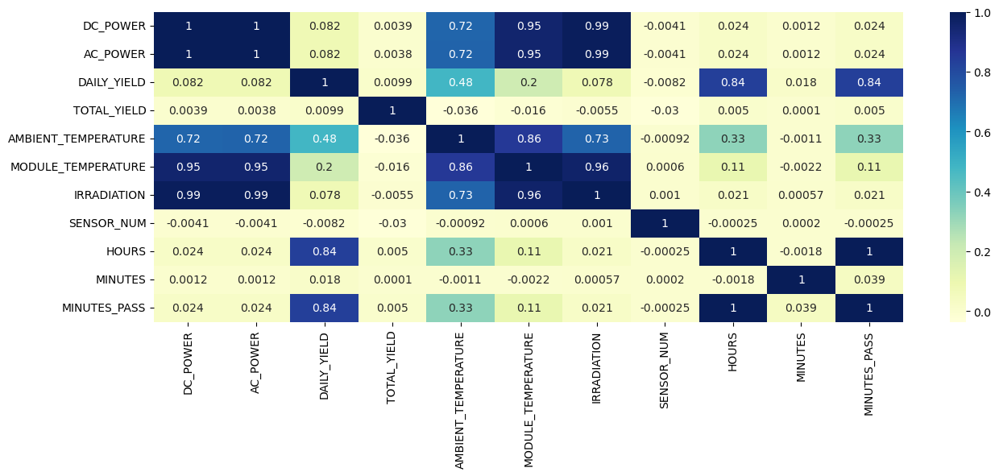

In [41]:
cols_corr = ["DC_POWER", "AC_POWER", "DAILY_YIELD", "TOTAL_YIELD", "AMBIENT_TEMPERATURE", "MODULE_TEMPERATURE", "IRRADIATION", "SENSOR_NUM", "HOURS", "MINUTES", "MINUTES_PASS"]
corrMatrix = df_plant1[cols_corr].corr()
plt.figure(figsize=(15,5))
fig_corr = sns.heatmap(corrMatrix,cmap="YlGnBu", annot=True)
plt.show()

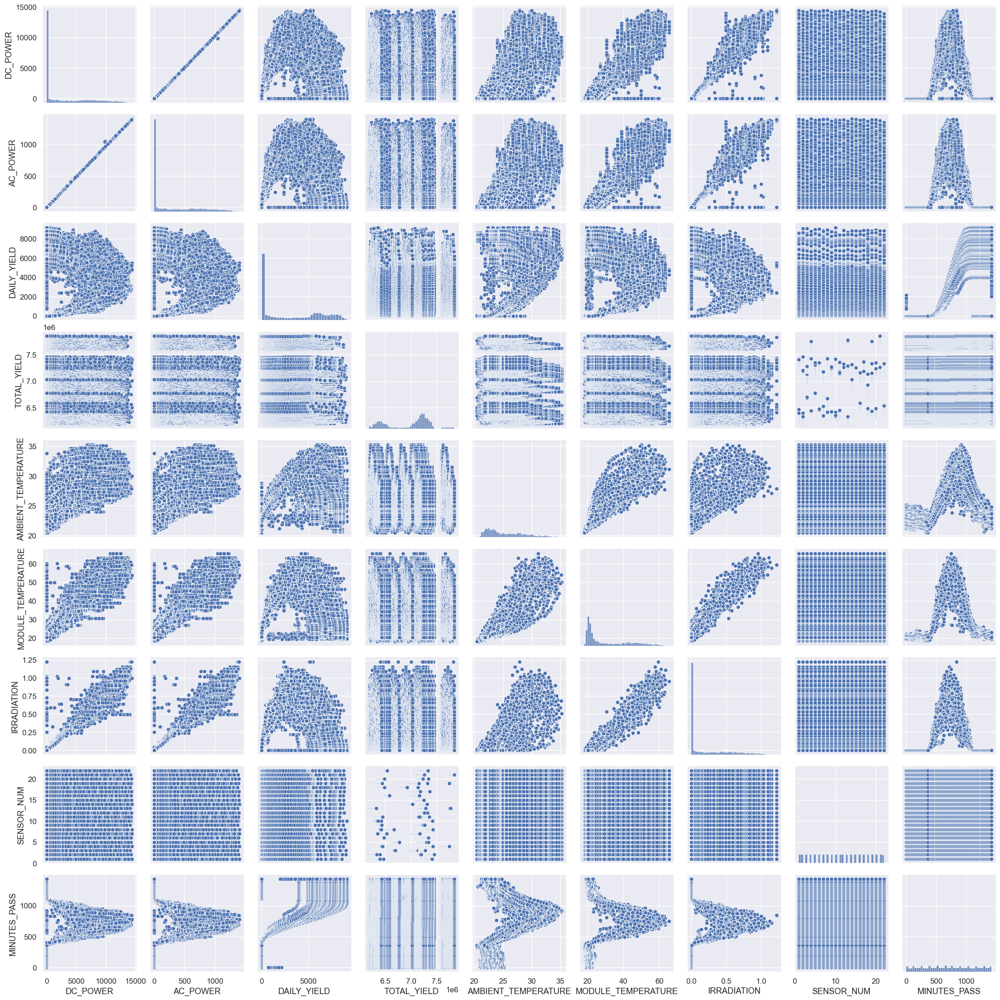

In [43]:
sns.set(style='darkgrid', palette="deep", font_scale=1.1, rc={"figure.figsize": [15, 5]})
cols_pair = ["DC_POWER", "AC_POWER", "DAILY_YIELD", "TOTAL_YIELD", "AMBIENT_TEMPERATURE", "MODULE_TEMPERATURE", "IRRADIATION", "SENSOR_NUM", "MINUTES_PASS"]
fig_pair = sns.pairplot(df_plant1[cols_pair])
plt.show()

From the last two figures we already can gain a lot of insight:

- high correlation between DC Power and AC Power
- high correlation between Power and Irradiation
- correlation between DC Power, AC Power and Module Temperature and Ambient Temperature
- correlation between Daily Yield and Ambient Temperature

and that there seem to be outliers in

- AC+DC Power - Irradiation
- DC Power - AC Power (very few)

We can use these outliers for equipment fault and need for maintenance detection!

- Outliers in Power-Irradiation indicate failure of the panel lines. If there is enough sunlight but no power is generated, this points to faulty photovoltaic cells.
- Outliers in DC-AC conversion indicate failure at the inverter. If there is DC power delivered but less AC power generated than expected the inverter may be malfunctioning.

If we take a close look at TOTAL_YIELD vs SENSOR_NUM, we see that there are two groups of inverters. One group starts with a higher total yield than the other one. This is most likely because this group was installed earlier than the other group.

NOTE: There are multiple entries where DAILY_YIELD decreased during a day, which should not be possible according to the definition of this column. Since Daily_YIELD is calculated from measured DC_POWER, there seems to be an issue with how this data was generated.

Let's look a bit more closer at the pairplots where we identified outliers and see if these are spread out evenly across all inverters or if we can identify specific inverters.

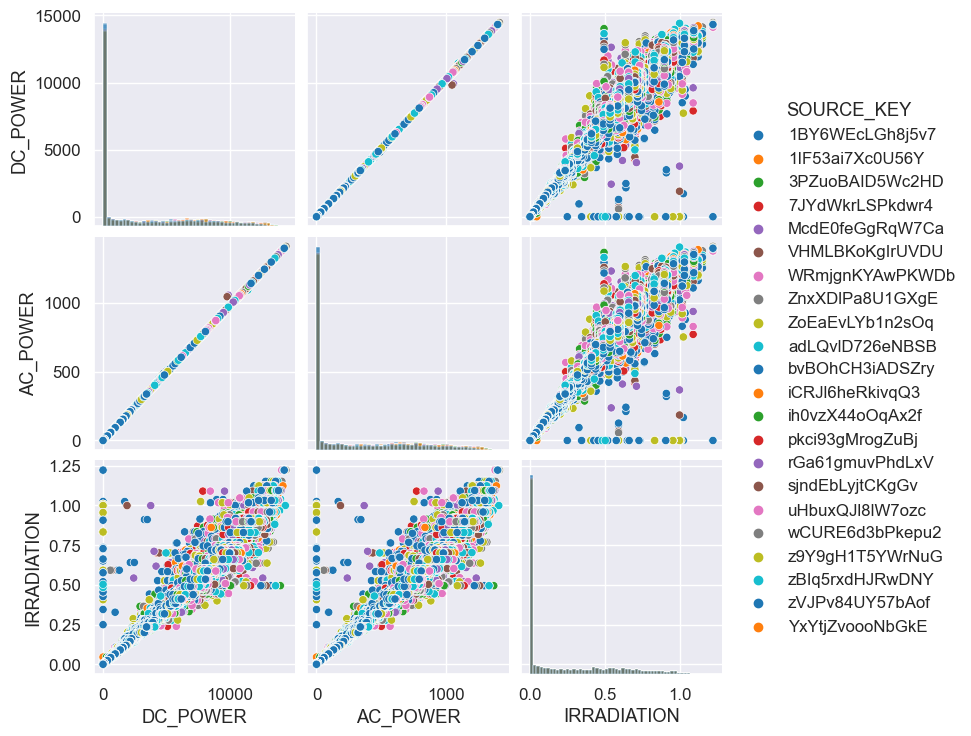

In [47]:
cols_out = ["DC_POWER", "AC_POWER", "IRRADIATION", "SOURCE_KEY"]
sns.pairplot(df_plant1[cols_out], hue="SOURCE_KEY", diag_kind="hist", palette="tab10")
plt.show()

The majority of the outliers appear to originate from a specific subset of inverters.

### AC Power vs DC Power

This demonstrates the efficiency of our inverter in converting DC power to AC power. Any anomalies observed during this conversion process can serve as indicators for detecting malfunctioning inverters.

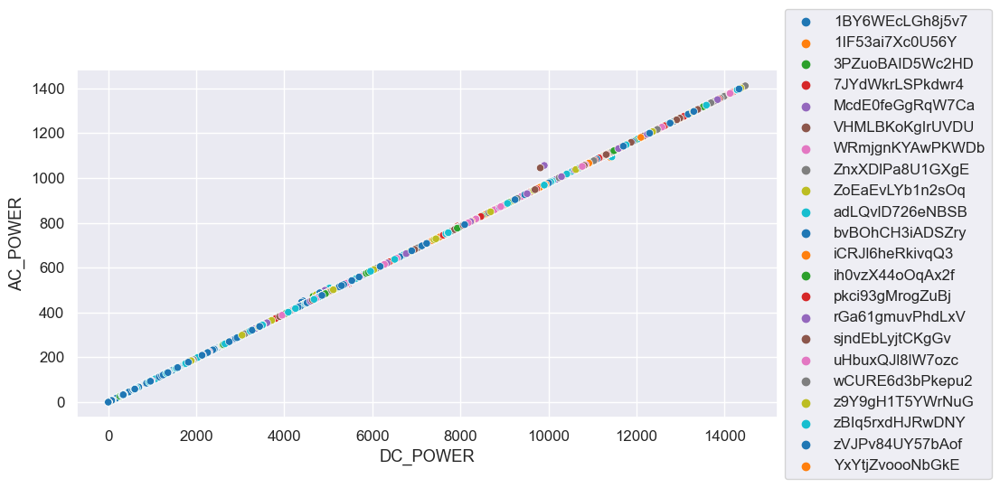

In [48]:
plt.figure(figsize=(10,5))
fig_power = sns.scatterplot(data=df_plant1, x="DC_POWER", y="AC_POWER", hue="SOURCE_KEY", palette="tab10")
fig_power.legend(loc='center left', bbox_to_anchor=(1, 0.5), ncol=1)
plt.show()

### Power vs Temperature

From our pairplots we can clearly see some outliers in the DC&AC Power vs Module Temperature. Other Temperatures do not show any obvious outliers

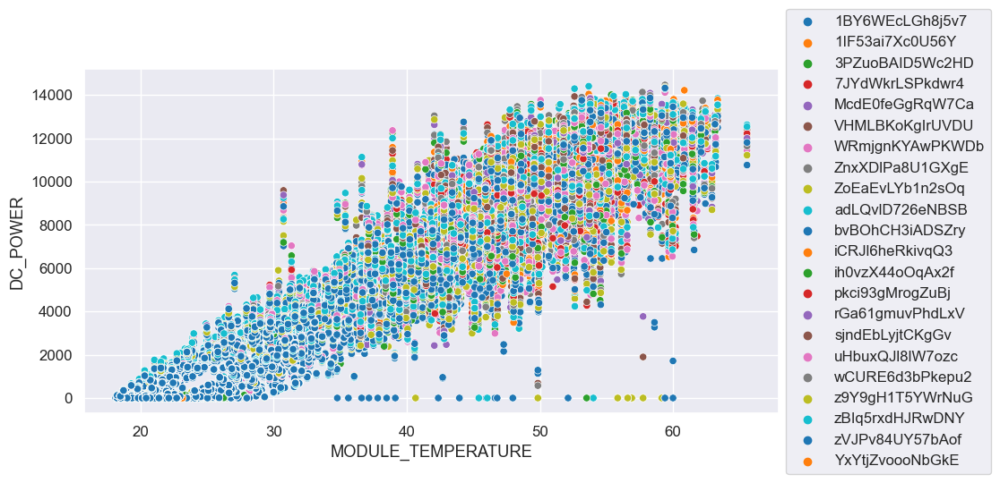

In [49]:
plt.figure(figsize=(10,5))
fig_temp = sns.scatterplot(data=df_plant1, x="MODULE_TEMPERATURE", y="DC_POWER", hue="SOURCE_KEY", palette="tab10")
fig_temp.legend(loc='center left', bbox_to_anchor=(1, 0.5), ncol=1)
plt.show()

### Power vs Irradiation

This reflects the effectiveness of our photovoltaic panel lines in transforming sunlight into DC power. Anomalies detected during this process of converting solar energy into electricity signify potential issues with malfunctioning photovoltaic panel lines.

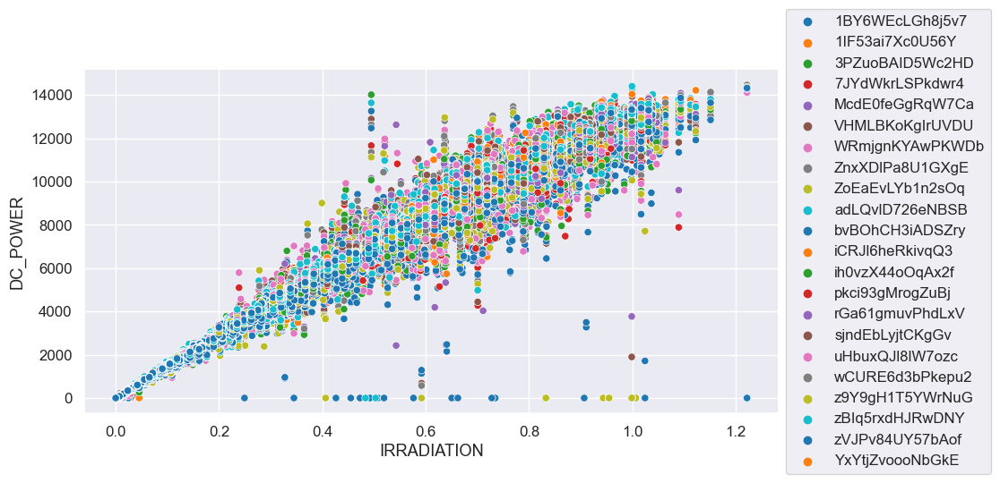

In [50]:
plt.figure(figsize=(10,5))
fig_irr = sns.scatterplot(data=df_plant1, x="IRRADIATION", y="DC_POWER", hue="SOURCE_KEY", palette="tab10")
fig_irr.legend(loc='center left', bbox_to_anchor=(1, 0.5), ncol=1)
plt.show()

Our data clearly shows events where some inverters received no DC power even though there was more than enough sunlight to generate power. We clearly have some equipment malfunction.

To illustrate this, we can take a closer look at the daily distribution of the generated power and the measured irradiation:

In [51]:
fig = px.scatter(df_plant1, x="TIME", y="DC_POWER", title="DC Power: Daily Distribution", color = "DATE_STR")
fig.update_traces(marker=dict(size=5, opacity=0.7), selector=dict(mode='markers'))
fig.show()

In [52]:
fig = px.scatter(df_plant1, x="TIME", y="IRRADIATION", title="Irradiation: Daily Distribution", color = "DATE_STR")
fig.update_traces(marker=dict(size=5, opacity=0.7), selector=dict(mode='markers'))
fig.show()

- The first figure shows multiple occasions where there was no power generated during daytime. 
- The second figure shows that the irradiation level never dropped low enough during the day to explain this loss of power. 

This indicates equipment failure.

### Temperature

In [53]:
df_plant1.MODULE_TEMPERATURE.describe()

count    68774.000000
mean        31.244997
std         12.308283
min         18.140415
25%         21.123944
50%         24.818984
75%         41.693659
max         65.545714
Name: MODULE_TEMPERATURE, dtype: float64

In [54]:
df_plant1.AMBIENT_TEMPERATURE.describe()

count    68774.000000
mean        25.558521
std          3.361300
min         20.398505
25%         22.724491
50%         24.670178
75%         27.960429
max         35.252486
Name: AMBIENT_TEMPERATURE, dtype: float64

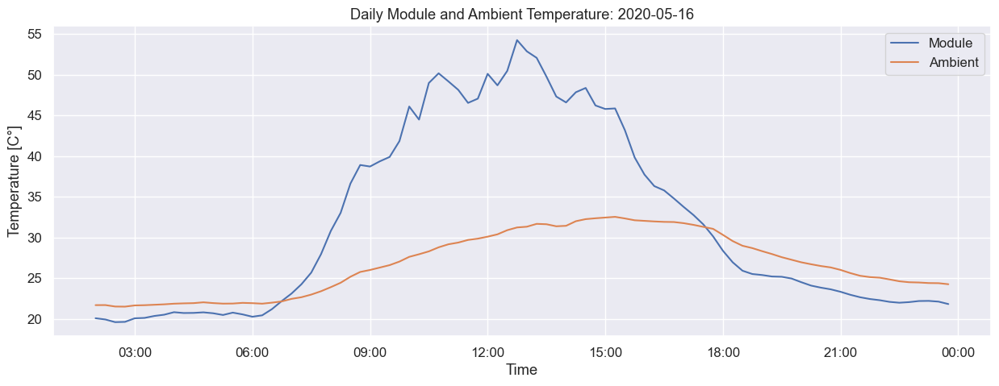

In [56]:
date=["2020-05-16"]
plt.plot(df_plant1[df_plant1["DATE_STR"].isin(date)].DATE_TIME, df_plant1[df_plant1["DATE_STR"].isin(date)].MODULE_TEMPERATURE, label="Module")
plt.plot(df_plant1[df_plant1["DATE_STR"].isin(date)].DATE_TIME, df_plant1[df_plant1["DATE_STR"].isin(date)].AMBIENT_TEMPERATURE, label="Ambient")
plt.gcf().axes[0].xaxis.set_major_formatter(xformatter) # set xaxis format
plt.legend()
plt.title("Daily Module and Ambient Temperature: {}" .format(date[0]))
plt.xlabel("Time")
plt.ylabel("Temperature [C°]")
plt.show()

Ambient temperatures fluctuate between 20 and 35°C, while module temperatures range from 18 to 65°C. Notably, modules tend to attain much higher temperatures than the surrounding air during daylight hours. There is a lag in ambient temperature compared to the daily cooldown of modules, indicating that the modules cool down faster than their surroundings.

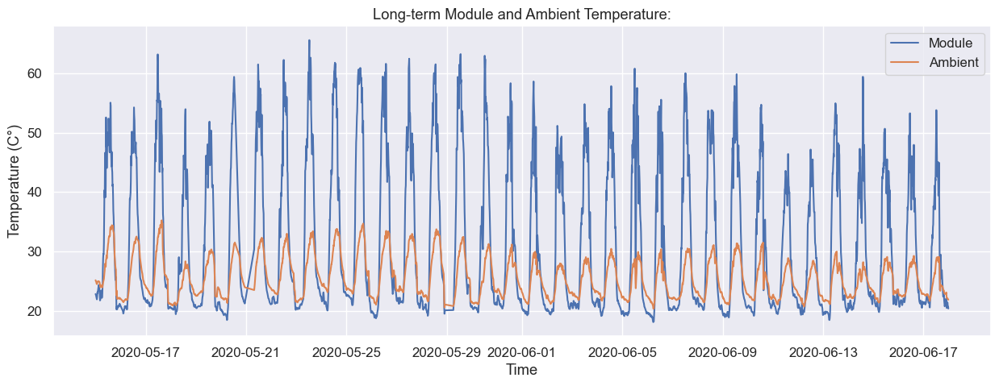

In [57]:
plt.plot(df_plant1.DATE_TIME, df_plant1.MODULE_TEMPERATURE, label="Module")
plt.plot(df_plant1.DATE_TIME, df_plant1.AMBIENT_TEMPERATURE, label="Ambient")
plt.title("Long-term Module and Ambient Temperature:")
plt.legend()
plt.xlabel("Time")
plt.ylabel("Temperature (C°)")
plt.show()

There are two days with significantly lower temperature ("bad weather") on. Such events may be difficult to forecast without access to more weather data (air pressure, wind, humidity, cloud formation etc.) and advanced weather forecasting models.

*NB: MODEL/THESIS LIMITATION*

## Condition Monitoring

We found evidence that point towards equipment failure. Now we are going to build models to detect equipment failure automatically.

#### Rule-based Fault Detection

During the data exploration we found a simple way to identify faulty equipment: If there is no power measured at the inverter during normal daytime operation, we can assume/identify equipment failure. Let's create a new column STATUS that identifies faulty operation:

In [58]:
# Function to check if time is during daytime operation
def time_in_range(start, end, x):
    """Return true if x is in the range [start, end]"""
    if start <= end:
        return start <= x <= end
    else:
        return start <= x or x <= end
    
# set normal daytime operation range
start=datetime.time(6,30,0) # sunrise
end=datetime.time(17,30,0) # sunset

# Create new column to check proper operation
# Return "Normal" if operation is normal and "Fault" if operation is faulty
df_plant1["STATUS"] = 0
for index in df_plant1.index:
    if  time_in_range(start, end, df_plant1["TIME"][index]) and df_plant1["DC_POWER"][index] == 0:
        df_plant1["STATUS"][index] = "Fault"
    else:
        df_plant1["STATUS"][index] = "Normal"

In [59]:
fig = px.scatter(df_plant1, x="IRRADIATION", y="DC_POWER", title="Fault Identification", color="STATUS", labels={"DC_POWER":"DC Power (kW)", "IRRADIATION":"Irradiation"})
fig.update_traces(marker=dict(size=3, opacity=0.7), selector=dict(mode='marker'))
fig.show()

Days with faults

In [60]:
df_plant1[df_plant1["STATUS"]== "Fault"]["DATE"].value_counts()

DATE
2020-06-07    32
2020-06-14    24
2020-05-15     2
2020-06-16     2
2020-06-17     2
2020-05-24     1
2020-05-25     1
2020-06-09     1
Name: count, dtype: int64

In [61]:
fig=px.bar(df_plant1[df_plant1["STATUS"]== "Fault"]["DATE"].value_counts(), title="Fault Events: Rule-based", labels={"value":"Faults", "index":"Date", "SENSOR_NAME":"Inverter"})
fig.update(layout_showlegend=False)

In [62]:
# Date & Inverter Time series
fig10 = px.scatter(df_plant1, x="DATE_TIME", y="STATUS", title="Fault Identification: Events", color="SOURCE_KEY")
fig10.update_traces(marker=dict(size=3, opacity=0.7), selector=dict(mode='marker'))
fig10.show()

In [63]:
# Faulty days
fig = px.scatter(df_plant1[df_plant1.DATE_STR=="2020-06-07"], x="DATE_TIME", y="DC_POWER", title="2020-06-07", color="SENSOR_NAME", labels={"DC_POWER":"DC Power", "DATE_TIME":"Time"})
fig.update_traces(marker=dict(size=3, opacity=0.7), selector=dict(mode='marker'))
fig.show()

In [65]:
fig = px.scatter(df_plant1[df_plant1.DATE_STR=="2020-06-14"], x="DATE_TIME", y="DC_POWER", title="2020-06-14", color="SENSOR_NAME", labels={"DC_POWER":"DC Power", "DATE_TIME":"Time"})
fig.update_traces(marker=dict(size=3, opacity=0.7), selector=dict(mode='marker'))
fig.show()

#### Number of recorded faults

In [66]:
df_plant1.STATUS.value_counts()

STATUS
Normal    68709
Fault        65
Name: count, dtype: int64

In [67]:
print(f"There are {df_plant1.STATUS.value_counts().Fault} records of faulty operation!")

There are 65 records of faulty operation!


#### Inverters with faults

In [68]:
df_plant1[df_plant1["STATUS"]== "Fault"]["SOURCE_KEY"].value_counts()

SOURCE_KEY
bvBOhCH3iADSZry    21
1BY6WEcLGh8j5v7    19
z9Y9gH1T5YWrNuG     7
wCURE6d3bPkepu2     5
zBIq5rxdHJRwDNY     3
McdE0feGgRqW7Ca     3
sjndEbLyjtCKgGv     3
zVJPv84UY57bAof     2
ih0vzX44oOqAx2f     1
iCRJl6heRkivqQ3     1
Name: count, dtype: int64

In [69]:
fig=px.bar(df_plant1[df_plant1["STATUS"]== "Fault"]["SOURCE_KEY"].value_counts(), title="Inverter Faults: Rule-based", labels={"value":"Faults", "index":"Inverter", "SENSOR_NAME":"Inverter"})
fig.update(layout_showlegend=False)

Can this plot be studied using Pareto?

#### Recap

In [76]:
print("The most faults were recorded on {} and {}." .format(df_plant1[df_plant1["STATUS"]== "Fault"]["DATE"].value_counts().index[0], df_plant1[df_plant1["STATUS"]== "Fault"]["DATE"].value_counts().index[1]))
print("Inverter {} and {} had the most failures." .format(df_plant1[df_plant1["STATUS"]== "Fault"]["SOURCE_KEY"].value_counts().index[0],df_plant1[df_plant1["STATUS"]== "Fault"]["SOURCE_KEY"].value_counts().index[1]))

The most faults were recorded on 2020-06-07 and 2020-06-14.
Inverter bvBOhCH3iADSZry and 1BY6WEcLGh8j5v7 had the most failures.


### Fault Detection with Regression Models

#### Linear Model

A first attempt at predicting DC power from irradiance by assuming a linear relationship

\begin{equation}
    P(t) = a + b \cdot E(t)
\end{equation}

with the generated DC power $P(t)$, irradiance $E(t)$ and coefficients $a ,b$.

Note: PV module panels can reach up to 65°C. The efficiency of PV cells is usually lower at high temperatures. This leads to a non-linear relationship between irradiance and generated DC power. We are going to model this nonlinearity in the next section.

In [77]:
from sklearn.linear_model import LinearRegression

# Model
reg = LinearRegression()

# choose training data
train_dates = ["2020-05-16", "2020-05-17","2020-05-18" ,"2020-05-19", "2020-05-20", "2020-05-21"]
df_train = df_plant1[df_plant1["DATE_STR"].isin(train_dates)]

#fit & predict
reg.fit(df_train[["IRRADIATION"]], df_train.DC_POWER)
prediction = reg.predict(df_plant1[["IRRADIATION"]])

# save prediction, residual, and absolute residual
df_train["Prediction"] = reg.predict(df_train[["IRRADIATION"]])
df_train["Residual"] = df_train["Prediction"] - df_train["DC_POWER"]
df_plant1["Prediction"] = reg.predict(df_plant1[["IRRADIATION"]])
df_plant1["Residual"] = df_plant1["Prediction"] - df_plant1["DC_POWER"]
df_plant1["Residual_abs"] = df_plant1["Residual"].abs()

In [79]:
fig = px.scatter(df_plant1, x="DATE_TIME", y="DC_POWER", title="Fault Identification: Linear model", color="Residual_abs", labels={"DC_POWER":"DC Power (kW)", "DATE_TIME":"Date Time", "Residual_abs":"Residual"}, range_x=[datetime.date(2020, 6, 1), datetime.date(2020, 6, 17)])
fig.update_traces(marker=dict(size=3, opacity=0.7), selector=dict(mode='marker'))
fig.show()

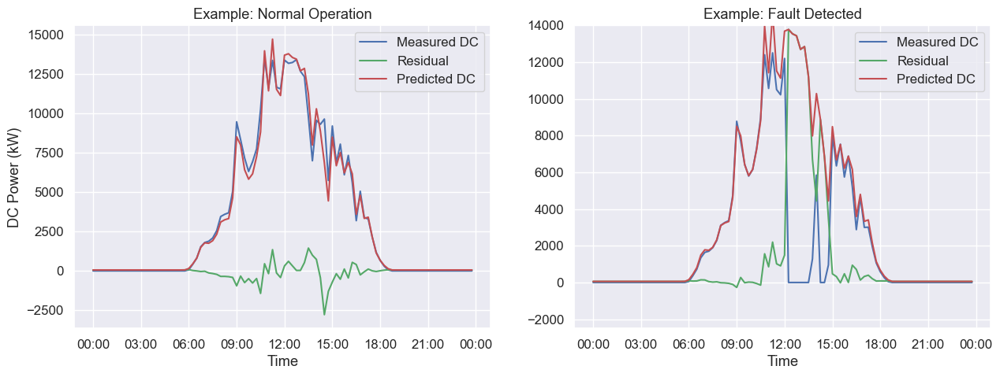

In [98]:
# choose data
day = "2020-06-07"
inverter1 = "2"
inverter2 = "22"
df_pred = df_plant1[(df_plant1["DATE_STR"] == day)].copy()

fig, axes = plt.subplots(1, 2)

sns.lineplot(x = df_pred.DATE_TIME, y= df_pred[df_pred["SENSOR_NAME"] == inverter1].DC_POWER, label="Measured DC", color="b", ax=axes[0])
sns.lineplot(x = df_pred.DATE_TIME, y = df_pred[df_pred["SENSOR_NAME"] == inverter1].Residual, label="Residual", color="g", ax=axes[0])
sns.lineplot(x = df_pred.DATE_TIME, y= df_pred[df_pred["SENSOR_NAME"] == inverter1].Prediction, label="Predicted DC", color="r", ax=axes[0])

sns.lineplot(x= df_pred.DATE_TIME, y = df_pred[df_pred["SENSOR_NAME"] == inverter2].DC_POWER, label="Measured DC", color="b", ax=axes[1])
sns.lineplot(x = df_pred.DATE_TIME, y = df_pred[df_pred["SENSOR_NAME"] == inverter2].Residual, label="Residual", color="g", ax=axes[1])
sns.lineplot(x = df_pred.DATE_TIME, y = df_pred[df_pred["SENSOR_NAME"] == inverter2].Prediction, label="Predicted DC", color="r", ax=axes[1])

plt.gcf().axes[0].xaxis.set_major_formatter(xformatter) # set xaxis format
plt.gcf().axes[1].xaxis.set_major_formatter(xformatter) # set xaxis format
axes[0].set_xlabel("Time")
axes[1].set_xlabel("Time")
axes[0].set_ylabel("DC Power (kW)")
axes[1].set_ylabel("")
axes[1].set_ylim(-2500, 14000)
axes[0].set_title("Example: Normal Operation")
axes[1].set_title("Example: Fault Detected")
plt.show()

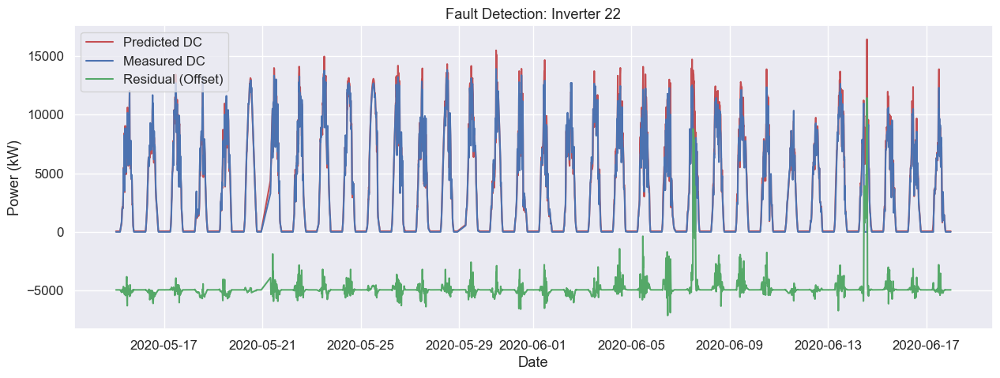

In [99]:
inverter2= "22"
df_pred2 = df_plant1[df_plant1["SENSOR_NAME"]==inverter2].copy()
sns.lineplot(x= df_pred2.DATE_TIME, y = df_pred2.Prediction, label="Predicted DC", color="r")
sns.lineplot(x = df_pred2.DATE_TIME, y= df_pred2.DC_POWER, label="Measured DC", color="b")
sns.lineplot(x = df_pred2.DATE_TIME, y = df_pred2.Residual-5000, label="Residual (Offset)", color="g")
plt.xlabel("Date")
plt.ylabel("Power (kW)")
plt.title("Fault Detection: Inverter 22")
plt.show()

#### Nonlinear Model

According to [Hooda et al. (2018)](https://www.researchgate.net/publication/309399733_PV_Power_Predictors_for_Condition_Monitoring) the generated power of a photovoltaic cell can be modeled by the nonlinear equation
\begin{equation}
    P(t) = a E(t) \left(1-b (T(t) + \frac{E(t)}{800} (c-20) - 25) - d \ln(E(t))\right)
\end{equation}
with irradiance $E(t)$, Temperature $T(t)$ and coefficients $a,b,c,d$.

In [85]:
def func(X, a, b, c, d):
    '''Nonlinear function to predict DC power output from Irradiation and Temperature.'''
    x,y = X
    x=x*1000
    y=y*1000
    return a*x*(1-b*(y+x/800*(c-20)-25)-d*np.log(x+1e-10))

# fit function
p0 = [1.,0.,-1.e4,-1.e-1] # starting values
popt, pcov = curve_fit(func, (df_train.IRRADIATION, df_train.MODULE_TEMPERATURE), df_train.DC_POWER, p0, maxfev=5000)
sigma_abcd = np.sqrt(np.diagonal(pcov))

# predict & save
df_train["Prediction_NL"] = func((df_train.IRRADIATION, df_train.MODULE_TEMPERATURE), *popt)
df_train["Residual_NL"] = df_train["Prediction_NL"] - df_train["DC_POWER"]

df_plant1["Prediction_NL"] = func((df_plant1.IRRADIATION, df_plant1.MODULE_TEMPERATURE), *popt)
df_plant1["Residual_NL"] = df_plant1["Prediction_NL"] - df_plant1["DC_POWER"]

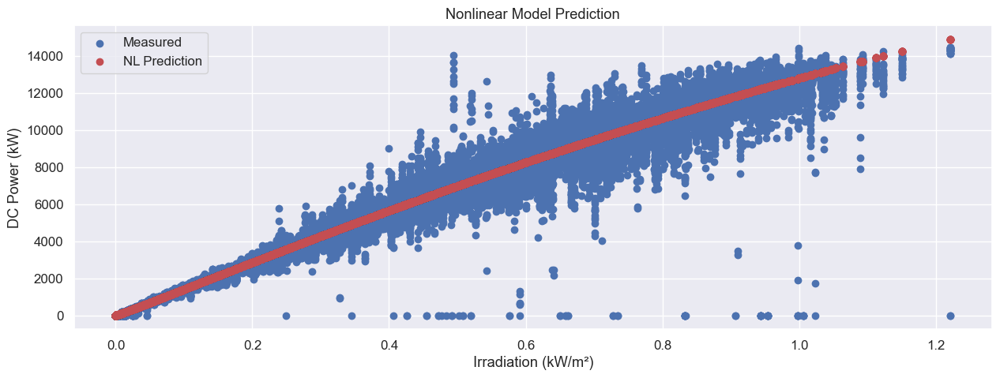

In [86]:
plt.scatter(df_plant1.IRRADIATION, df_plant1.DC_POWER, label="Measured")
plt.scatter(df_plant1.IRRADIATION, df_plant1.Prediction_NL, color="r", label="NL Prediction")
plt.legend()
plt.xlabel("Irradiation (kW/m²)")
plt.ylabel("DC Power (kW)")
plt.title("Nonlinear Model Prediction")
plt.show()

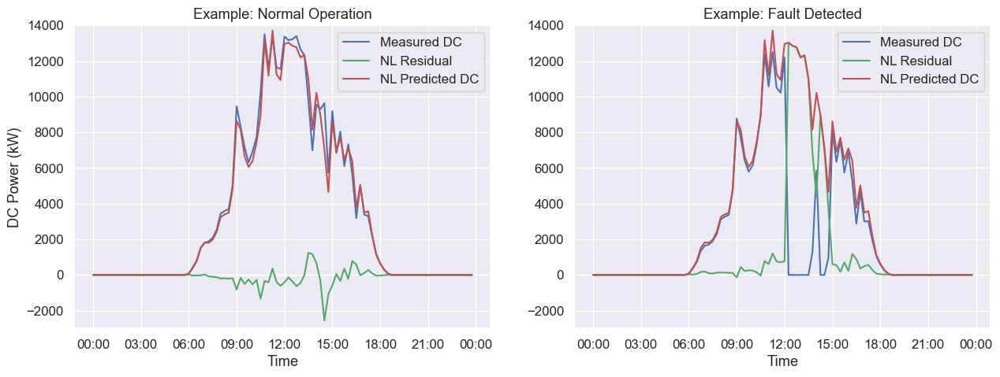

In [100]:
# choose data
day = "2020-06-07"
inverter1 = "2"
inverter2 = "22"
df_pred = df_plant1[(df_plant1["DATE_STR"] == day)].copy()

fig, axes = plt.subplots(1, 2)

sns.lineplot(x = df_pred.DATE_TIME, y = df_pred[df_pred["SENSOR_NAME"] == inverter1].DC_POWER, label="Measured DC", color="b", ax=axes[0])
sns.lineplot(x = df_pred.DATE_TIME, y = df_pred[df_pred["SENSOR_NAME"] == inverter1].Residual_NL, label="NL Residual", color="g", ax=axes[0])
sns.lineplot(x = df_pred.DATE_TIME, y = df_pred[df_pred["SENSOR_NAME"] == inverter1].Prediction_NL, label="NL Predicted DC", color="r", ax=axes[0])

sns.lineplot(x = df_pred.DATE_TIME, y = df_pred[df_pred["SENSOR_NAME"] == inverter2].DC_POWER, label="Measured DC", color="b", ax=axes[1])
sns.lineplot(x = df_pred.DATE_TIME, y = df_pred[df_pred["SENSOR_NAME"] == inverter2].Residual_NL, label="NL Residual", color="g", ax=axes[1])
sns.lineplot(x = df_pred.DATE_TIME, y = df_pred[df_pred["SENSOR_NAME"] == inverter2].Prediction_NL, label="NL Predicted DC", color="r", ax=axes[1])

plt.gcf().axes[0].xaxis.set_major_formatter(xformatter) # set xaxis format
plt.gcf().axes[1].xaxis.set_major_formatter(xformatter) # set xaxis format
axes[0].set_xlabel("Time")
axes[1].set_xlabel("Time")
axes[0].set_ylabel("DC Power (kW)")
axes[1].set_ylabel("")
axes[0].set_ylim(-3000, 14000)
axes[1].set_ylim(-3000, 14000)
axes[0].set_title("Example: Normal Operation")
axes[1].set_title("Example: Fault Detected")
plt.show()

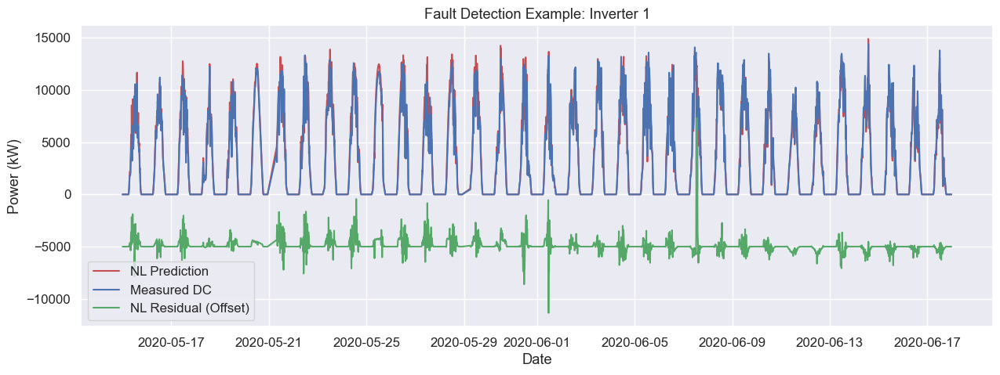

In [97]:
inverter2= "1"
df_pred2 = df_plant1[df_plant1["SENSOR_NAME"]==inverter2].copy()
sns.lineplot(x = df_pred2.DATE_TIME, y = df_pred2.Prediction_NL, label="NL Prediction", color="r")
sns.lineplot(x = df_pred2.DATE_TIME,y = df_pred2.DC_POWER, label="Measured DC", color="b")
sns.lineplot(x = df_pred2.DATE_TIME, y = df_pred2.Residual_NL-5000, label="NL Residual (Offset)", color="g")
plt.xlabel("Date")
plt.ylabel("Power (kW)")
plt.title("Fault Detection Example: Inverter {}".format(inverter2))
plt.show()

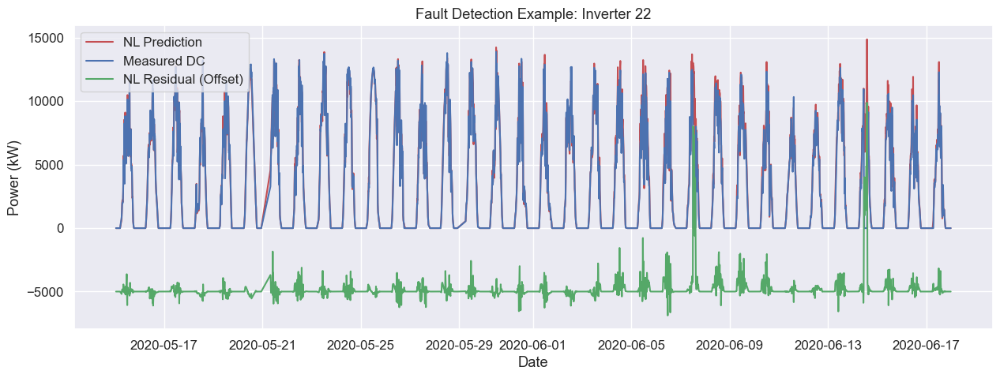

In [101]:
inverter2= "22"
df_pred2 = df_plant1[df_plant1["SENSOR_NAME"]==inverter2].copy()
sns.lineplot(x = df_pred2.DATE_TIME, y = df_pred2.Prediction_NL, label="NL Prediction", color="r")
sns.lineplot(x = df_pred2.DATE_TIME, y = df_pred2.DC_POWER, label="Measured DC", color="b")
sns.lineplot(x = df_pred2.DATE_TIME, y = df_pred2.Residual_NL-5000, label="NL Residual (Offset)", color="g")
plt.xlabel("Date")
plt.ylabel("Power (kW)")
plt.title("Fault Detection Example: Inverter {}".format(inverter2))
plt.show()

#### Model Comparison

To compare the two models we can take a look at their respective residuals. The nonlinear model seems to perform slightly better than the linear model, especially at times of high irradiance.

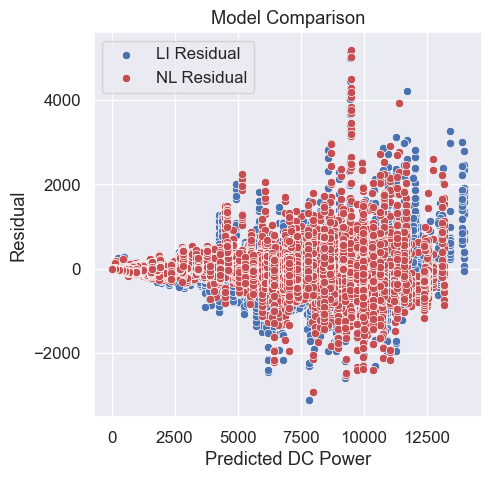

In [103]:
# plot model comparison residual
plt.figure(figsize=(5,5))
sns.scatterplot(x = df_train.Prediction, y = df_train.Residual, color="b", label="LI Residual")
sns.scatterplot(x = df_train.Prediction_NL, y = df_train.Residual_NL, color="r", label="NL Residual")
axes = plt.gca()
plt.ylabel("Residual")
plt.xlabel("Predicted DC Power")
plt.title("Model Comparison")
plt.show()

#### NL Fault Detection

Let's now use the irradiance and temperature data to predict the expected DC power with the nonlinear model. This allows us to identify addtional anomalies by comparing the measured DC power with the prediction. The additional anomalies indicate equipment underperformance or need for maintenance.

In [104]:
# set confidence range for residual for fault
limit_fault=4000

# Create new column to check proper operation
# Return "Normal" if operation is normal and "Fault" if operation is faulty
df_plant1["STATUS_NL"] = 0
for index in df_plant1.index:
    if  df_plant1["Residual_NL"][index] > limit_fault:
        df_plant1["STATUS_NL"][index] = "Fault"  
    else:
        df_plant1["STATUS_NL"][index] = "Normal"

In [105]:
fig=px.bar(df_plant1[df_plant1["STATUS_NL"]== "Fault"]["DATE"].value_counts(), title="Faults: Nonlinear Model", labels={"value":"Faults", "index":"Date", "SENSOR_NAME":"Inverter"}, )
fig.update(layout_showlegend=False)

In [106]:
fig=px.bar(df_plant1[df_plant1["STATUS_NL"]== "Fault"]["SOURCE_KEY"].value_counts(), title="Underperformance & Faults: Nonlinear Model", labels={"value":"Faults", "index":"Inverter", "SENSOR_NAME":"Inverter"})
fig.update(layout_showlegend=False)

In [108]:
fig = px.scatter(df_plant1, x="DATE_TIME", y="DC_POWER", title="Underperformance & Faults: Nonlinear Model", color="STATUS_NL", labels={"DC_POWER":"DC Power (kW)", "DATE_TIME":"Date Time", "STATUS_NL":"Status"},range_x=[datetime.date(2020, 6, 1), datetime.date(2020, 6, 17)])
fig.update_traces(marker=dict(size=3, opacity=0.7), selector=dict(mode='marker'))
fig.show()

In [109]:
print("The most anomalies were recorded on {} and {}." .format(df_plant1[df_plant1["STATUS_NL"]== "Fault"]["DATE"].value_counts().index[0], df_plant1[df_plant1["STATUS_NL"]== "Fault"]["DATE"].value_counts().index[1]))
print("Inverter {} and {} had the most events of failure/underperformance." .format(df_plant1[df_plant1["STATUS_NL"]== "Fault"]["SOURCE_KEY"].value_counts().index[0],df_plant1[df_plant1["STATUS_NL"]== "Fault"]["SOURCE_KEY"].value_counts().index[1]))

The most anomalies were recorded on 2020-06-07 and 2020-06-14.
Inverter 1BY6WEcLGh8j5v7 and bvBOhCH3iADSZry had the most events of failure/underperformance.
